# <h1><center>Business Buddy</center></h1>
![alt text](Buddy.png "Title")

In [4]:
# import statements
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
db_file = 'yelp_reviews.db'

## Helper functions
import os
import sqlite3
from sqlite3 import Error

def create_connection(db_file, delete_db=False):
    if delete_db and os.path.exists(db_file):
        os.remove(db_file)
    conn = None
    try:
        conn = sqlite3.connect(db_file)
        conn.execute("PRAGMA foreign_keys = 1")
    except Error as e:
        print(e)

    return conn

In [5]:
from IPython.display import HTML

HTML('''<script>
code_show=true;
function code_toggle() {
if (code_show){
$('div.input').hide();
} else {
$('div.input').show();
}
code_show = !code_show
}
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"><input type="submit" value="Click here to toggle on/off the raw code."></form>''')

In [59]:
import numpy as np
import matplotlib.pyplot as plt
import os,conda

conda_file_dir = conda.__file__
conda_dir = conda_file_dir.split('lib')[0]
proj_lib = os.path.join(os.path.join(conda_dir, 'share'), 'proj')
os.environ["PROJ_LIB"] = proj_lib

from mpl_toolkits.basemap import Basemap
from wordcloud import WordCloud, STOPWORDS
%matplotlib inline
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)


import re # We clean text using regex
import csv # To read the csv
from collections import defaultdict # For accumlating values
from nltk.corpus import stopwords # To remove stopwords
from gensim import corpora # To create corpus and dictionary for the LDA model
from gensim.models import LdaModel # To use the LDA model
import pyLDAvis.gensim # To visualise LDA model effectively
import pandas as pd

### 1.1 Where are Yelp's businesses located?

from IPython.display import HTML
HTML('''<script>
code_show_err=false; 
function code_toggle_err() {
 if (code_show_err){
 $('div.output_stderr').hide();
 } else {
 $('div.output_stderr').show();
 }
 code_show_err = !code_show_err
} 
$( document ).ready(code_toggle_err);
</script>
To toggle on/off output_stderr, click <a href="javascript:code_toggle_err()">here</a>.''')

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



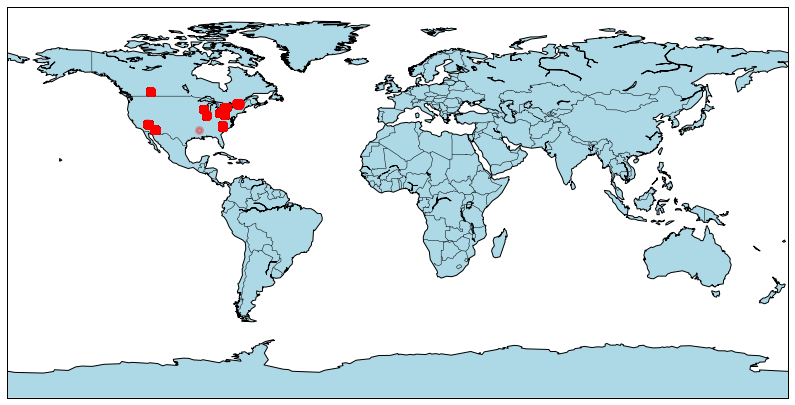

In [132]:
conn = create_connection(db_file)
locationDetails = pd.read_sql("""SELECT latitude,longitude
FROM business""", conn)
fig = plt.figure(figsize=(14, 8), edgecolor='w')

m = Basemap(projection='cyl',llcrnrlon= -180, urcrnrlon = 180,
            llcrnrlat = -90, urcrnrlat= 90,resolution='c',
           lat_ts = True)
m.drawcoastlines()
m.fillcontinents(color='#add8e6',lake_color='#add8e6')
m.drawcountries()
m.drawmapboundary(fill_color='#FFFFFF')

mloc = m(locationDetails['latitude'].tolist(),locationDetails['longitude'].tolist())
print(mloc)
m.scatter(mloc[1],mloc[0],color ='red',lw=3,alpha=0.3,zorder=5)

### 1.2 What are the top 10 cities based on business reviewed on Yelp

In [19]:
conn = create_connection(db_file)
top10Cities = pd.read_sql("""SELECT Count(*), city
FROM business
GROUP BY city
ORDER BY Count(*) DESC
LIMIT 10""", conn)


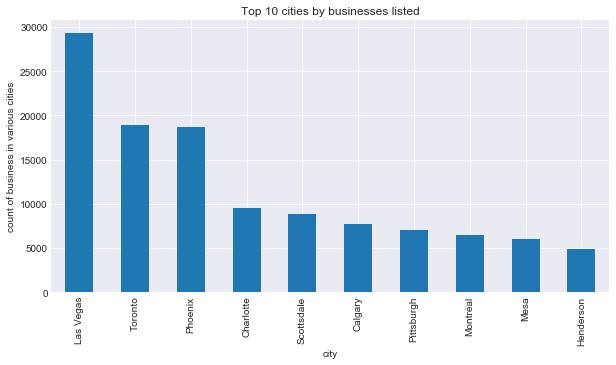

In [108]:
top10Cities.plot(kind="bar", figsize=(10,5),legend=None)
plt.title('Top 10 cities by businesses listed')
plt.ylabel('count of business in various cities')
plt.show()

### 1.3 What category of business are flourishing in these top cities????

In [22]:
conn = create_connection(db_file)
LasVegasBusiness = pd.read_sql("""SELECT * 
FROM business
WHERE city="Las Vegas" 
LIMIT 10""", conn)

In [63]:
conn = create_connection("yelp_reviews.db")
Top3Business = pd.read_sql("""SELECT * 
FROM business
WHERE city in (\"Las Vegas\", \"Phoenix\", \"Toronto\") """, conn)

In [79]:
import plotly.graph_objects as go
import ipywidgets as widgets
category_dd = widgets.Dropdown(options = list(Top3Business["city"].unique()), 
                               description = "Select City", disabled =False,)
category_dd

Dropdown(description='Select City', options=('Phoenix', 'Las Vegas', 'Toronto'), value='Phoenix')

Toronto


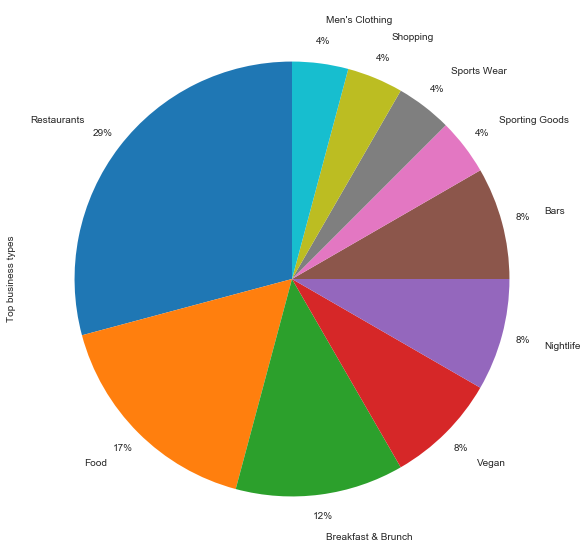

In [133]:
conn = create_connection("yelp_reviews.db")
selected_category = str(category_dd).split("value")[1][2:-2]
print(selected_category)
df1 = pd.read_sql_query("""SELECT * 
FROM business
WHERE city=\"{}\" 
LIMIT 10""".format(selected_category), conn)
cat_data = df1
num_cat=10
Categories={}
for cat in cat_data.categories.values:
    all_categories= cat.split(",")
    for x in all_categories:
        x=x.strip()
        try :
            Categories[x] =Categories[x]+1
        except:
            Categories[x]=1
top_categories = pd.DataFrame.from_dict(data= Categories,orient="index")
top_categories.reset_index(inplace=True)
top_categories.columns = ['category', 'occurance']
x_val=top_categories.sort_values("occurance")[::-1][:num_cat].occurance.values
labels=top_categories.sort_values("occurance")[::-1][:num_cat].category.values
series = pd.Series(x_val, index=labels, name='Top business types')
series.plot.pie(figsize=(10, 10),startangle=90,autopct='%1.0f%%', pctdistance=1.1, labeldistance=1.2)

### 1.4 Distibution of Stars across all business types

In [24]:
conn = create_connection(db_file)
starsCount = pd.read_sql("""SELECT count(*) as noOfBusiness,stars
FROM business
GROUP BY stars""", conn)

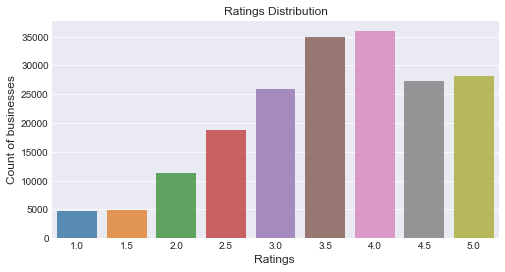

In [110]:
x=starsCount.sort_index()
#plot
plt.figure(figsize=(8,4))
ax= sns.barplot(x.stars, x.noOfBusiness, alpha=0.8)
plt.title("Ratings Distribution")
plt.ylabel('Count of businesses', fontsize=12)
plt.xlabel('Ratings ', fontsize=12)

plt.show()

### 1.5 Top 10 Reviewed business

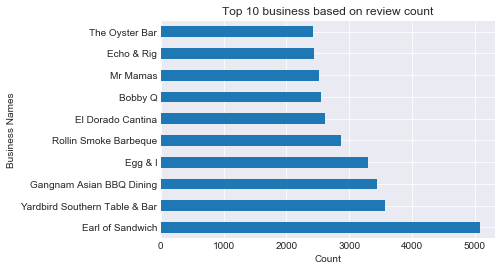

In [136]:
conn = create_connection(db_file)
top10ReviewedBusiness = pd.read_sql("""SELECT business_id,name,review_count,stars,categories FROM business
WHERE stars>4
ORDER BY review_count DESC
LIMIT 10""",conn)
#print(top10ReviewedBusiness)
top10ReviewedBusiness.plot(kind='barh',x='name',y='review_count',legend=None)
plt.title('Top 10 business based on review count')
plt.ylabel('Business Names')
plt.xlabel('Count')
plt.show()

In [27]:
import plotly.graph_objects as go
import ipywidgets as widgets
category_dd = widgets.Dropdown(options = list(top10ReviewedBusiness["categories"].unique()), 
                               description = "Select Category", disabled =False,)
category_dd

conn = create_connection(db_file)
top10ReviewedBusiness = pd.read_sql("""SELECT business_id,name,review_count,stars,categories FROM business
WHERE stars>4
ORDER BY review_count DESC
LIMIT 10""",conn)


### 1.6 What categories do the top business belong to???

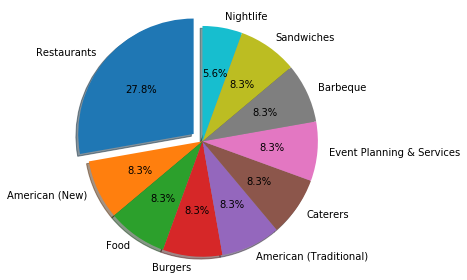

In [29]:
# Categories of top business
num_cat =10 # to show top 10 catrgories
top_business = 30 # choose categories of top 30 businesses
cat_data = top10ReviewedBusiness
#print(cat_data.categories)
Categories={}
for cat in cat_data.categories.values:
    all_categories= cat.split(",")
    for x in all_categories:
        x=x.strip()
        try :
            Categories[x] =Categories[x]+1
        except:
            Categories[x]=1
top_categories = pd.DataFrame.from_dict(data= Categories,orient="index")
top_categories.reset_index(inplace=True)
top_categories.columns = ['category', 'occurance']

x_val=top_categories.sort_values("occurance")[::-1][:num_cat].occurance.values
labels=top_categories.sort_values("occurance")[::-1][:num_cat].category.values
#series = pd.Series(x_val, index=labels, name='Top business types')
#series.plot.pie(figsize=(10, 10),startangle=90,autopct='%1.0f%%', pctdistance=1.1, labeldistance=1.2)

explode = (0.1,0,0,0,0,0,0,0,0,0)
fig1, ax1 = plt.subplots()
ax1.pie(x_val, explode=explode, labels=labels, autopct='%1.1f%%',
        shadow=True, startangle=90,radius=1)
ax1.axis('equal')  
plt.tight_layout()
plt.show()

### 1.7 Bottom 10 reviewed businesses

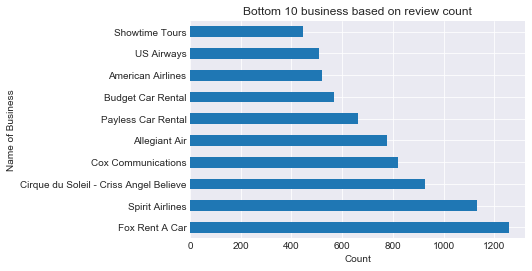

In [138]:
conn = create_connection(db_file)
bottom10ReviewedBusiness = pd.read_sql("""SELECT business_id,name,review_count,stars,categories FROM business
WHERE stars<2
ORDER BY review_count DESC
LIMIT 10""",conn)
#print(bottom10ReviewedBusiness)
bottom10ReviewedBusiness.plot(kind='barh',x='name',y='review_count',legend=None)
plt.ylabel('Name of Business')
plt.xlabel('Count')
plt.title('Bottom 10 business based on review count')
plt.show()


### 1.8 What Categories do these bottom businesses belong to???

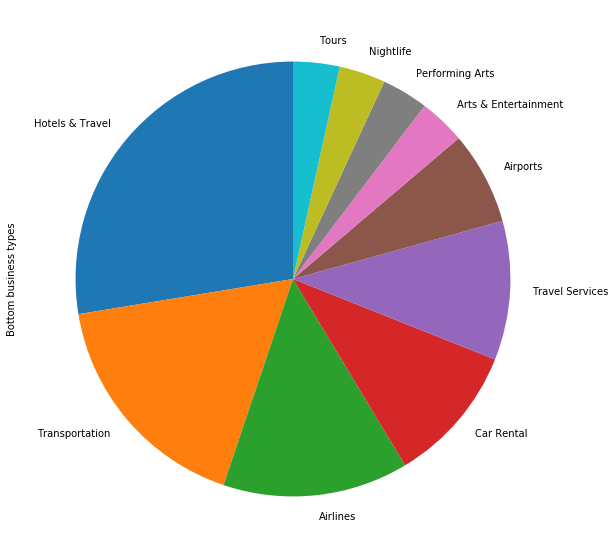

In [31]:
# Categories of bottom business
num_cat =10 # to show top 10 catrgories
bottom_business = 30 # choose categories of top 30 businesses
cat_data = bottom10ReviewedBusiness
#print(cat_data.categories)
Categories={}
for cat in cat_data.categories.values:
    all_categories= cat.split(",")
    for x in all_categories:
        x=x.strip()
        try :
            Categories[x] =Categories[x]+1
        except:
            Categories[x]=1
top_categories = pd.DataFrame.from_dict(data= Categories,orient="index")
top_categories.reset_index(inplace=True)
top_categories.columns = ['category', 'occurance']

x_val=top_categories.sort_values("occurance")[::-1][:num_cat].occurance.values
labels=top_categories.sort_values("occurance")[::-1][:num_cat].category.values
series = pd.Series(x_val, index=labels, name='Bottom business types')
series.plot.pie(figsize=(10, 10),startangle=90)

## Zoom into your location to see the listed businesses

In [111]:
import plotly.graph_objects as go
mapbox_access_token = 'pk.eyJ1Ijoic2F1cmFiaDdtIiwiYSI6ImNrM2VwcjI5czAwcjkzZ3BoZ2prdWx0YXQifQ.ejOfLVmpLsM-r9KZH5pFYQ'


# Take data of all listed businesses
conn = create_connection(db_file)
business = pd.read_sql("""SELECT name,stars,latitude,longitude FROM business""",conn)
nameAndStars = business[['name', 'stars']].copy()

# difine our data for ploting on mapbox
fig = go.Figure(go.Scattermapbox(
        lat=business.latitude.tolist(),
        lon=business.longitude.tolist(),
        mode='markers',
        # add 'bar' as a marker icon. so it's look beautiful 
        marker=go.scattermapbox.Marker(
            symbol='bar',
            size=9
        ),
         text=nameAndStars.values.tolist(),
    )
)



# dfine our map layout
fig.update_layout(
    # add title
    title='Zoom to your location and find your desire restaurants',
    autosize=True,
    hovermode='closest',
    mapbox=dict(
        # add our access token
        accesstoken=mapbox_access_token,
        bearing=0,
        # add center location to our map
        center=dict(
            lat=39.4440302947,
            lon=-98.9565517008
        ),
        # use style light
        style='light',
        pitch=0,
        # zoom label to 3
        zoom=3
    ),
)

fig.show()
# # let's make the final figure
# data= dict(fig, layout=layout)
# # finally plot the map
# py.iplot(data, filename='Multiple Mapbox')

In [ ]:
### <h1><center>Let's check the checkins for Earl of Sandwich on different days of the week</center></h1>
![alt text](EarlOfSandwich.jpg "Title")

In [ ]:
### WORD CLOUD for Good Reviews

In [35]:
conn = create_connection("yelp_reviews_new.db")
earl_of_sandwich_df = pd.read_sql(
    "SELECT * from reviews where business_id=\"DkYS3arLOhA8si5uUEmHOw\";",
    conn)

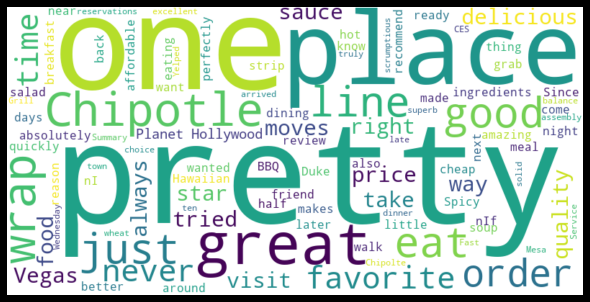

In [134]:
text = earl_of_sandwich_df.text.values
stop_words = ["sandwiches", "sandwich", "Avocado","is", "I", "the","bread", "for", "on", "of", "to", "but", "that", "are", "can", "got", "at", "can","sure", "chicken", "earl", "we", "go", "have", "every", "let", "then", "was", "got","i", "me", "my", "myself", "we", "our", "ours", "ourselves", "you", "your", "yours", "yourself", "yourselves", "he", "him", "his", "himself", "she", "her", "hers", "herself", "it", "its", "itself", "they", "them", "their", "theirs", "themselves", "what", "which", "who", "whom", "this", "that", "these", "those", "am", "is", "are", "was", "were", "be", "been", "being", "have", "has", "had", "having", "do", "does", "did", "doing", "a", "an", "the", "and", "but", "if", "or", "because", "as", "until", "while", "of", "at", "by", "for", "with", "about", "against", "between", "into", "through", "during", "before", "after", "above", "below", "to", "from", "up", "down", "in", "out", "on", "off", "over", "under", "again", "further", "then", "once", "here", "there", "when", "where", "why", "how", "all", "any", "both", "each", "few", "more", "most", "other", "some", "such", "no", "nor", "not", "only", "own", "same", "so", "than", "too", "very", "s", "t", "can", "will"]
wordcloud = WordCloud(
    width = 800,
    height = 400,
    background_color = 'white', 
    stopwords = stop_words, max_words=100).generate(str(text))
fig = plt.figure(
    figsize = (8, 8),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

### WORD CLOUD for Bad Reviews for Earl Of Sandwich

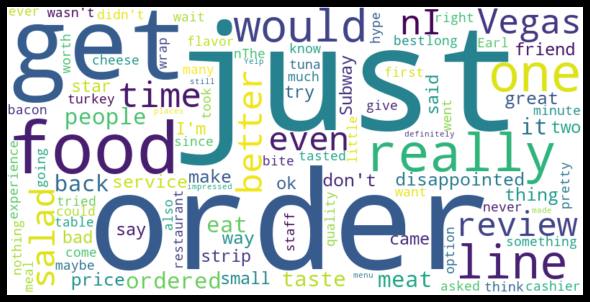

In [135]:
earl_of_sandwich_bad_reviews = earl_of_sandwich_df[earl_of_sandwich_df.stars < 3]
stop_words = ["sandwiches","like","good", "place", "sandwich", "Avocado","is", "I", "the","bread", "for", "on", "of", "to", "but", "that", "are", "can", "got", "at", "can","sure", "chicken", "earl", "we", "go", "have", "every", "let", "then", "was", "got","i", "me", "my", "myself", "we", "our", "ours", "ourselves", "you", "your", "yours", "yourself", "yourselves", "he", "him", "his", "himself", "she", "her", "hers", "herself", "it", "its", "itself", "they", "them", "their", "theirs", "themselves", "what", "which", "who", "whom", "this", "that", "these", "those", "am", "is", "are", "was", "were", "be", "been", "being", "have", "has", "had", "having", "do", "does", "did", "doing", "a", "an", "the", "and", "but", "if", "or", "because", "as", "until", "while", "of", "at", "by", "for", "with", "about", "against", "between", "into", "through", "during", "before", "after", "above", "below", "to", "from", "up", "down", "in", "out", "on", "off", "over", "under", "again", "further", "then", "once", "here", "there", "when", "where", "why", "how", "all", "any", "both", "each", "few", "more", "most", "other", "some", "such", "no", "nor", "not", "only", "own", "same", "so", "than", "too", "very", "s", "t", "can", "will"]


text = earl_of_sandwich_bad_reviews.text.values

wordcloud = WordCloud(
    width = 800,
    height = 400,
    background_color = 'white', 
    stopwords = stop_words, max_words=100).generate(str(text))

fig = plt.figure(
    figsize = (8, 8),
    facecolor = 'k',
    edgecolor = 'k')

plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

In [39]:
import nltk
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Nikita\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping corpora\stopwords.zip.


True

### Clustering of words being talked about most on reviews

In [61]:
import re
reviews = [re.sub(r'[^\w\s]','',str(item)) for item in earl_of_sandwich_df.text.values]
stopwords = set(stopwords.words('english'))
texts = [[word for word in document.lower().split() if word not in stopwords] for document in reviews]
dictionary = corpora.Dictionary(texts)
corpus = [dictionary.doc2bow(text) for text in texts]
NUM_TOPICS = 9 # This is an assumption. 
ldamodel = LdaModel(corpus, num_topics = NUM_TOPICS, id2word=dictionary, passes=15)
topics = ldamodel.show_topics()
lda_display = pyLDAvis.gensim.prepare(ldamodel, corpus, dictionary, sort_topics=False)
pyLDAvis.display(lda_display)

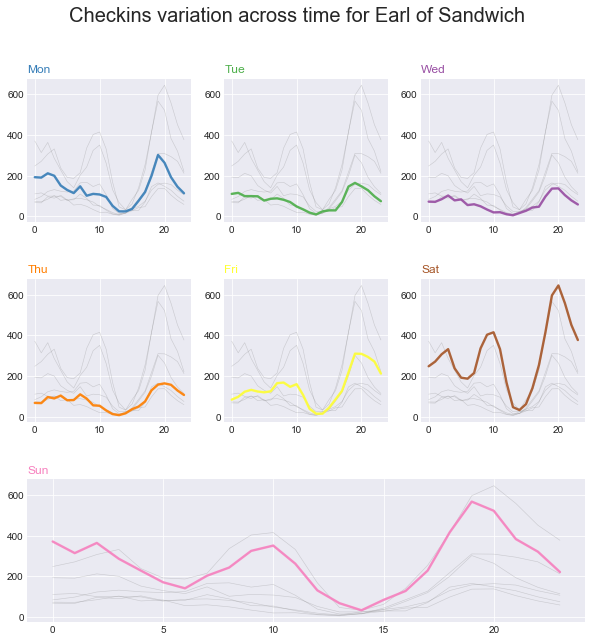

In [92]:
conn=create_connection('yelp_reviews.db')
sql="SELECT * FROM checkin where business_id='DkYS3arLOhA8si5uUEmHOw'"
dates = pd.read_sql(sql,conn).date.str.split(',')
df=pd.DataFrame(list(zip(dates.values[0])))
df.columns=["date_time"]
df['date_time'] = pd.to_datetime(df['date_time'])
df['date'] = df['date_time'].dt.date
df['hour'] = df['date_time'].dt.hour
df['minute'] = df['date_time'].dt.minute
df['second'] = df['date_time'].dt.second
df['weekday'] = df['date_time'].dt.weekday
df
#checkins exploration
df=df.groupby(['weekday','hour'])['date_time'].count()
df=df.reset_index()
df=df.pivot(index='hour',columns='weekday')[['date_time']]
df.columns = df.columns.droplevel()
df=df.reset_index()
# Workaround for not being able to sort the values by hour
df.hour=df.hour.apply(lambda x: str(x).split(':')[0])
df.hour=df.hour.astype(int)
# Sort the hour column 
df=df.sort_values('hour')
df.columns=['hour','Mon', 'Tue','Wed','Thu','Fri','Sat', 'Sun']
df
#viz
import matplotlib.pyplot as plt
import seaborn as sns 
import matplotlib.gridspec as gridspec 
import matplotlib.gridspec as gridspec 

# graph viz
import plotly.offline as pyo
from plotly.graph_objs import *
import plotly.graph_objs as go

# Initialize the figure
plt.style.use('seaborn-darkgrid')
# create a color palette
palette = plt.get_cmap('Set1')
plt.figure(figsize=(10,10))
plt.suptitle("Checkins variation across time for Earl of Sandwich",fontsize=20)
gridspec.GridSpec(3,3)
plt.subplots_adjust(hspace=0.4)
# multiple line plot
num=0
for column in df.drop('hour', axis=1):
    num+=1
# Find the right spot on the plot
    
    if num==7:  # adjustment to fit sunday
        plt.subplot2grid((3,3),(2,0),colspan=3)
    else:
        plt.subplot(3,3, num)
    
# plot every groups, but discreet
    for v in df.drop('hour', axis=1):
        plt.plot(df['hour'], df[v], marker='', color='grey', linewidth=0.6, alpha=0.3)
# Plot the lineplot
    plt.plot(df['hour'], df[column], marker='', color=palette(num), linewidth=2.4, alpha=0.9, label=column)
# Add title
    plt.title(column, loc='left', fontsize=12, fontweight=0, color=palette(num))



### <h1><center>Let's look at the worst reviewed business :  Fox Rent a Car</center></h1>
![alt text](Fox.png "Title")

In [91]:
conn=create_connection('yelp_reviews.db')
df = pd.read_sql(
    "SELECT r.*, b.name FROM reviews r left join business b on r.business_id = b.business_id where b.business_id='e0CTLPxTnFEQSqQ1FJUqog'",
    conn)


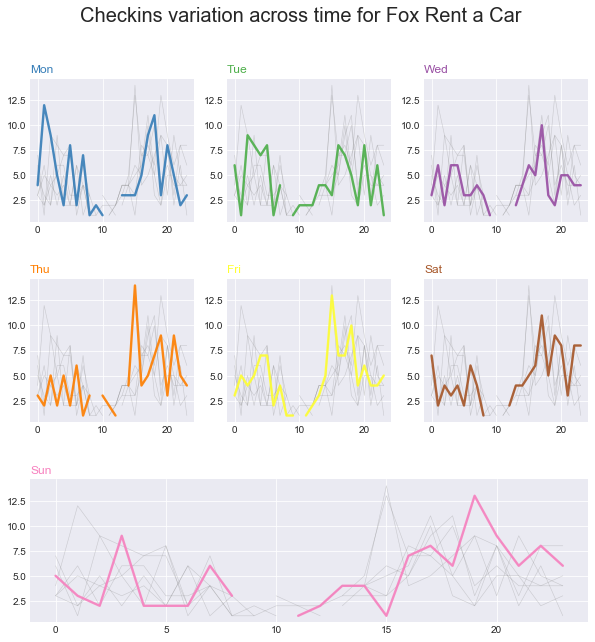

In [93]:
conn=create_connection('yelp_reviews.db')
sql="SELECT * FROM checkin where business_id='e0CTLPxTnFEQSqQ1FJUqog'"
dates = pd.read_sql(sql,conn).date.str.split(',')
df=pd.DataFrame(list(zip(dates.values[0])))
df.columns=["date_time"]
df['date_time'] = pd.to_datetime(df['date_time'])
df['date'] = df['date_time'].dt.date
df['hour'] = df['date_time'].dt.hour
df['minute'] = df['date_time'].dt.minute
df['second'] = df['date_time'].dt.second
df['weekday'] = df['date_time'].dt.weekday
df
#checkins exploration
df=df.groupby(['weekday','hour'])['date_time'].count()
df=df.reset_index()
df=df.pivot(index='hour',columns='weekday')[['date_time']]
df.columns = df.columns.droplevel()
df=df.reset_index()
# Workaround for not being able to sort the values by hour
df.hour=df.hour.apply(lambda x: str(x).split(':')[0])
df.hour=df.hour.astype(int)
# Sort the hour column 
df=df.sort_values('hour')
df.columns=['hour','Mon', 'Tue','Wed','Thu','Fri','Sat', 'Sun']
df
#viz
import matplotlib.pyplot as plt
import seaborn as sns 
import matplotlib.gridspec as gridspec 
import matplotlib.gridspec as gridspec 

# graph viz
import plotly.offline as pyo
from plotly.graph_objs import *
import plotly.graph_objs as go

# Initialize the figure
plt.style.use('seaborn-darkgrid')
# create a color palette
palette = plt.get_cmap('Set1')
plt.figure(figsize=(10,10))
plt.suptitle("Checkins variation across time for Fox Rent a Car",fontsize=20)
gridspec.GridSpec(3,3)
plt.subplots_adjust(hspace=0.4)
# multiple line plot
num=0
for column in df.drop('hour', axis=1):
    num+=1
# Find the right spot on the plot
    
    if num==7:  # adjustment to fit sunday
        plt.subplot2grid((3,3),(2,0),colspan=3)
    else:
        plt.subplot(3,3, num)
    
# plot every groups, but discreet
    for v in df.drop('hour', axis=1):
        plt.plot(df['hour'], df[v], marker='', color='grey', linewidth=0.6, alpha=0.3)
# Plot the lineplot
    plt.plot(df['hour'], df[column], marker='', color=palette(num), linewidth=2.4, alpha=0.9, label=column)
# Add title
    plt.title(column, loc='left', fontsize=12, fontweight=0, color=palette(num))



# Future Enhancements
### Current version focuses on business. We will incorporate collaborative filtering capabilities to help customers find the best business
### Collect more user data and advise businesses on Loyalty programmes for frequent users